<a href="https://colab.research.google.com/github/neethipoonacha/EIP3/blob/master/Tensorflow_catsndogs.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
import numpy as np
import tensorflow as tf


In [0]:
fashion_mnist = tf.keras.datasets.fashion_mnist
(train_images,train_labels),(test_images,test_labels) = fashion_mnist.load_data()

4423680/4422102 [==============================] - 0s 0us/step


[[  0   0   0   0   0   1   0   0   0   0  41 188 103  54  48  43  87 168
  133  16   0   0   0   0   0   0   0   0]
 [  0   0   0   1   0   0   0  49 136 219 216 228 236 255 255 255 255 217
  215 254 231 160  45   0   0   0   0   0]
 [  0   0   0   0   0  14 176 222 224 212 203 198 196 200 215 204 202 201
  201 201 209 218 224 164   0   0   0   0]
 [  0   0   0   0   0 188 219 200 198 202 198 199 199 201 196 198 198 200
  200 200 200 201 200 225  41   0   0   0]
 [  0   0   0   0  51 219 199 203 203 212 238 248 250 245 249 246 247 252
  248 235 207 203 203 222 140   0   0   0]
 [  0   0   0   0 116 226 206 204 207 204 101  75  47  73  48  50  45  51
   63 113 222 202 206 220 224   0   0   0]
 [  0   0   0   0 200 222 209 203 215 200   0  70  98   0 103  59  68  71
   49   0 219 206 214 210 250  38   0   0]
 [  0   0   0   0 247 218 212 210 215 214   0 254 243 139 255 174 251 255
  205   0 215 217 214 208 220  95   0   0]
 [  0   0   0  45 226 214 214 215 224 205   0  42  35  60  16  1

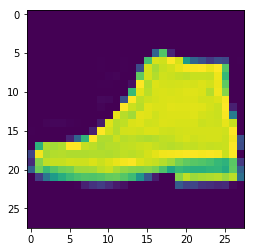

In [0]:
import matplotlib.pyplot as plt 
plt.imshow(train_images[42])

print(train_images[1])
print(train_labels[1])

In [0]:
train_images = train_images/255.0
test_images = test_images/255.0

In [0]:
model = tf.keras.Sequential([
    tf.keras.layers.Flatten(input_shape=(28,28)),
    tf.keras.layers.Dense(128 , activation=tf.nn.relu),
    tf.keras.layers.Dense(10 , activation=tf.nn.softmax)
])

W0812 15:54:18.993569 140096566986624 deprecation.py:506] From /usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/init_ops.py:1251: calling VarianceScaling.__init__ (from tensorflow.python.ops.init_ops) with dtype is deprecated and will be removed in a future version.
Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor


In [0]:
class myCallBack(tf.keras.callbacks.Callback):
  def on_epoch_end(self,epoch,los={}): #init function 
    if(get('loss')<0.4):
      print("\loss is low so cancelling training!")
      self.model.stop_training = True

In [0]:
callback = myCallBack()

model.compile(optimizer = tf.train.AdamOptimizer(),
             loss = "sparse_categorical_crossentropy")

##,callbacks=[callback]
model.fit(train_images,train_labels,epochs=5)

Epoch 1/5
60000/60000 [==============================] - 4s 74us/sample - loss: 0.4975
Epoch 2/5
60000/60000 [==============================] - 4s 65us/sample - loss: 0.3741
Epoch 3/5
60000/60000 [==============================] - 4s 64us/sample - loss: 0.3357
Epoch 4/5
60000/60000 [==============================] - 4s 67us/sample - loss: 0.3099
Epoch 5/5
60000/60000 [==============================] - 4s 66us/sample - loss: 0.2939


In [0]:
model.evaluate(test_images,test_labels)

10000/10000 [==============================] - 0s 34us/sample - loss: 0.3523


0.3522812719941139

In [0]:
#!pip install --upgrade tensorflow
import numpy as np
import tensorflow as tf 

#print(tf._version_)

mnist = tf.keras.datasets.fashion_mnist
(train_images,train_labels),(test_images,test_labels)= mnist.load_data();

train_images = train_images.reshape(60000,28,28,1)
train_images = train_images/255.0
test_images = test_images.reshape(10000,28,28,1)
test_images = test_images/255.0

model = tf.keras.models.Sequential([
    tf.keras.layers.Conv2D(64,(3,3),activation='relu',input_shape=[28,28,1]),
    tf.keras.layers.MaxPooling2D(2,2),
    tf.keras.layers.Conv2D(64,(3,3),activation='relu'),
    tf.keras.layers.MaxPooling2D(2,2),
    tf.keras.layers.Conv2D(64,(3,3),activation='relu'),
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(128,activation='relu'),
    tf.keras.layers.Dense(10,activation='softmax') 
])


#model.compile(optimizer="adam",loss="categorical_entropy")
model.compile(optimizer = tf.train.AdamOptimizer(),
             loss = "sparse_categorical_crossentropy")
model.summary()
model.fit(train_images,train_labels,epochs=5)
model.evaluate(test_images,test_labels)

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 26, 26, 64)        640       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 13, 13, 64)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 11, 11, 64)        36928     
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 5, 5, 64)          0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 3, 3, 64)          36928     
_________________________________________________________________
flatten_1 (Flatten)          (None, 576)               0         
_________________________________________________________________
dense_2 (Dense)              (None, 128)              

0.2619097833991051

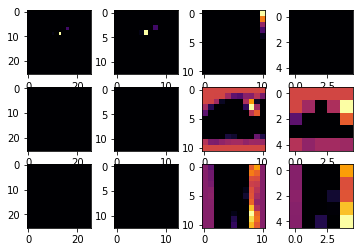

In [0]:
import matplotlib.pyplot as plt 
f, axarr = plt.subplots(3,4)
FIRST_IMAGE = 1
SECOND_IMAGE = 9
THIRD_IMAGE =3 
CONVOLUTION_NUMBER = 63

from tensorflow.keras import models 
layer_outputs = [layer.output for layer in model.layers]
activation_model = tf.keras.models.Model(inputs = model.input , outputs = layer_outputs)
for x in range(0,4):
  f1 = activation_model.predict(test_images[FIRST_IMAGE].reshape(1,28,28,1))[x]
  axarr[0,x].imshow(f1[0,:,:,CONVOLUTION_NUMBER],cmap ='inferno')
  axarr[0,x].grid(False)
  
  f2 = activation_model.predict(test_images[SECOND_IMAGE].reshape(1,28,28,1))[x]
  axarr[1,x].imshow(f2[0,:,:,CONVOLUTION_NUMBER],cmap ='inferno')
  axarr[1,x].grid(False)
  
  f3 = activation_model.predict(test_images[THIRD_IMAGE].reshape(1,28,28,1))[x]
  axarr[2,x].imshow(f3[0,:,:,CONVOLUTION_NUMBER],cmap ='inferno')
  axarr[2,x].grid(False)
  


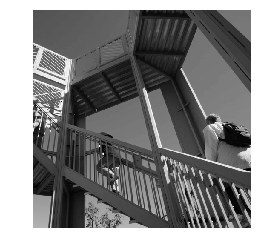

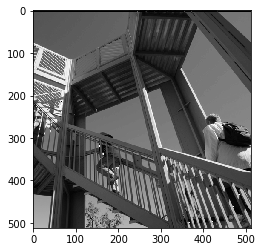

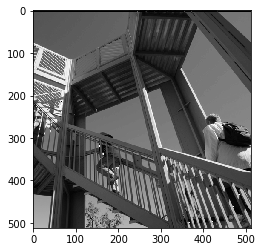

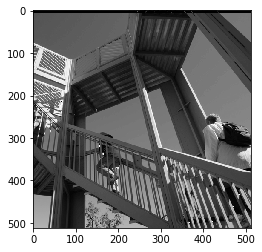

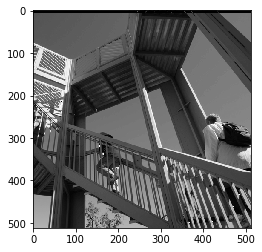

...

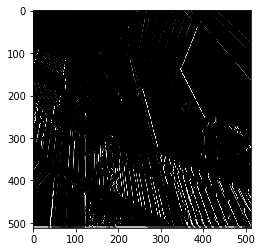

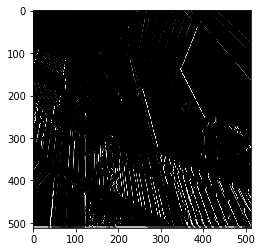

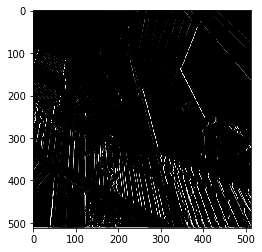

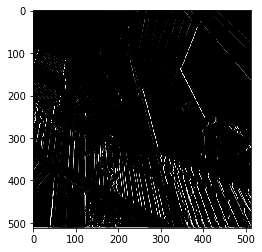

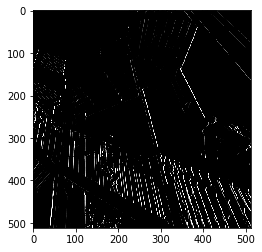

In [0]:
#lets create a convoultuion on a 3D Grayscale image
import cv2
import numpy as np
from scipy import misc
i= misc.ascent()

#now plot the image to see how it looks
import matplotlib.pyplot as plt
plt.grid(False)
plt.gray()
plt.axis('off')
plt.imshow(i)
plt.show()

#the image is stored as a numpy array , so that we can plot back the transformed image by copying the array 
#lets see the dimensions of the image so that we can loop through later
i_transformed = np.copy(i)
size_x = i_transformed.shape[0]
size_y = i_transformed.shape[1]

#now create 3*3 kernels/filters

#this kernel detects edges nicly ,it creates a convoultion that only passes through sharp edges and straight lines
#vertical edge filter
#filter = [[0,1,0],[1,-4,1],[0,1,0]]

#some experiments of filters for fun !!
filter = [[-1,-3,-1],[0,0,0],[1,2,1]]
#filter = [[-1,0,1],[-2,0,2],[-1,0,1]]

#Note - the summation of all points in a filter should ideally add up to 1 . If not we need to add/sub to normalise the weights

weight = 1

#NOW LETS CREATE THE CONVOLUTION LAYER

#We will iterate over the image leaving a 1 pixel margin,and nultiply out each of the neighbours with the pixel value mentioned in the filter
#i,e the current pixels neighbour - the above it and left of it will be multiplied with top left of filter we'll then multiply the resukt by the weight and ensure that 
#the weight is in the range 0-255
#finally we send the new value in to the transformed image

for x in range(3 , size_x-1):
  for y in range(1,size_y-1):
    conv = 0.0
    conv = conv + (i[x-1,y-1]*filter[0][0])
    conv = conv + (i[x,y-1]*filter[0][1])
    conv = conv + (i[x+1,y-1]*filter[0][2])
    conv = conv + (i[x-1,y-1]*filter[0][0])
    conv = conv + (i[x,y-1]*filter[1][1])
    conv = conv + (i[x+1,y-1]*filter[1][2])  
    conv = conv + (i[x-1,y+1]*filter[2][0])
    conv = conv + (i[x,y+1]*filter[2][1])
    conv = conv + (i[x+1,y+1]*filter[2][2])
    conv = conv*weight
    if(conv<0):
      conv=0
    if(conv>255):
      conv=255
    i_transformed[x,y] = conv
  
  
  #Now we plot the image after convoultions !!!!!
  #Note the size of the axis - they are 512 * 512
  plt.gray()
  plt.grid(False)
  plt.imshow(i_transformed)
  plt.show()
  


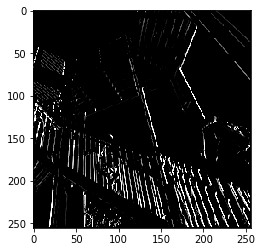

In [0]:
#Now add MaxPooling !!!!! 
#the idea is take the max of the 4 pixels in each block

new_x = int(size_x/2)
new_y = int(size_y/2)
newImage = np.zeros([new_x,new_y])

for x in range (0,size_x-2):
  for y in range (0,size_y-2):
   pixels = []
   pixels.append(i_transformed[x,y])
   pixels.append(i_transformed[x+1,y])
   pixels.append(i_transformed[x,y+1])
   pixels.append(i_transformed[x+1,y+1])
   pixels.sort(reverse=True)
   newImage[int(x/2),int(y/2)]=pixels[0]
   
  
#Plot the image now the size will be 256 instead of 512
plt.gray()
plt.grid(False)
plt.imshow(newImage)
plt.show()

In [1]:
!wget --no-check-certificate \
  https://storage.googleapis.com/laurencemoroney-blog.appspot.com/horse-or-human.zip \
  -O /tmp/horse-or-human.zip
 
#unzip the files in to /tmp directory in this virtual machine

!wget --no-check-certificate \
  https://storage.googleapis.com/laurencemoroney-blog.appspot.com/validation-horse-or-human.zip \
  -O /tmp/validation-horse-or-human.zip

--2019-08-13 13:44:23--  https://storage.googleapis.com/laurencemoroney-blog.appspot.com/horse-or-human.zip
Resolving storage.googleapis.com (storage.googleapis.com)... 209.85.234.128, 2607:f8b0:4001:c1e::80
Connecting to storage.googleapis.com (storage.googleapis.com)|209.85.234.128|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 149574867 (143M) [application/zip]
Saving to: ‘/tmp/horse-or-human.zip’

/tmp/horse-or-human 100%[===================>] 142.65M   158MB/s    in 0.9s    

2019-08-13 13:44:24 (158 MB/s) - ‘/tmp/horse-or-human.zip’ saved [149574867/149574867]

--2019-08-13 13:44:25--  https://storage.googleapis.com/laurencemoroney-blog.appspot.com/validation-horse-or-human.zip
Resolving storage.googleapis.com (storage.googleapis.com)... 64.233.181.128, 2607:f8b0:4001:c1e::80
Connecting to storage.googleapis.com (storage.googleapis.com)|64.233.181.128|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 11480187 (11M) [application/z

In [0]:
#the below code is to unzip files from above file system and give access to subdirectories
import os
import zipfile

localzip = '/tmp/horse-or-human.zip'
zip_ref = zipfile.ZipFile(localzip,'r')
zip_ref.extractall('/tmp/horse-or-human')

localzip = '/tmp/validation-horse-or-human.zip'
zip_ref = zipfile.ZipFile(localzip,'r')
zip_ref.extractall('/tmp/validation-horse-or-human')

zip_ref.close()

In [0]:
#create the training set of humans and horses - inshort ur sayin 'this is what the horse looks like'
#image generator will label the images automatically for us by doing the below step
train_horse_dir = os.path.join('/tmp/horse-or-human/horses')
train_human_dir = os.path.join('/tmp/horse-or-human/humans')

validation_horse_dir = os.path.join('/tmp/validation-horse-or-human/horses')
validation_human_dir = os.path.join('/tmp/validation-horse-or-human/humans')



['horse32-2.png', 'horse30-8.png', 'horse46-9.png', 'horse25-6.png', 'horse26-6.png', 'horse18-1.png', 'horse41-9.png', 'horse31-0.png', 'horse50-6.png', 'horse43-3.png']
['human06-02.png', 'human09-26.png', 'human07-12.png', 'human08-27.png', 'human14-04.png', 'human02-14.png', 'human06-12.png', 'human13-03.png', 'human06-29.png', 'human15-02.png']
['horse2-294.png', 'horse6-089.png', 'horse5-076.png', 'horse1-122.png', 'horse4-345.png', 'horse6-064.png', 'horse5-478.png', 'horse2-254.png', 'horse5-203.png', 'horse3-521.png']
['valhuman02-06.png', 'valhuman04-06.png', 'valhuman05-03.png', 'valhuman05-08.png', 'valhuman02-15.png', 'valhuman01-23.png', 'valhuman01-04.png', 'valhuman05-05.png', 'valhuman04-20.png', 'valhuman05-26.png']
total training images of horse 500
total training images of horse 527
total validation images of horse 128
total validation images of horse 128


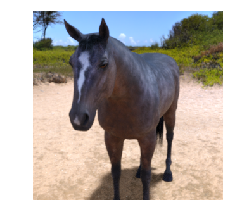

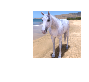

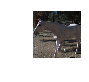

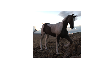

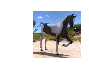

...

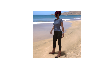

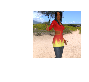

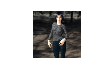

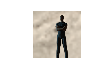

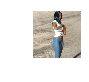

In [4]:
#now lets see how file names  look like 
train_horse_names = os.listdir(train_horse_dir)
print(train_horse_names[:10])

train_human_names = os.listdir(train_human_dir)
print(train_human_names[:10])


validation_horse_names = os.listdir(validation_horse_dir)
print(validation_horse_names[:10])

validation_human_names = os.listdir(validation_human_dir)
print(validation_human_names[:10])

#total number of horse and human images
print('total training images of horse', len(os.listdir(train_horse_dir)))
print('total training images of horse', len(os.listdir(train_human_dir)))
print('total validation images of horse', len(os.listdir(validation_horse_dir)))
print('total validation images of horse', len(os.listdir(validation_human_dir)))

import matplotlib.image as mpimg
import matplotlib.pyplot as plt
nrows = 4
ncols = 4
pic_index = 0
fig = plt.gcf()
fig.set_size_inches(ncols*4 ,nrows*4)
pic_index += 8
next_horse_pix = [os.path.join(train_horse_dir,fname)
                 for fname in train_horse_names[pic_index-8:pic_index]]

next_human_pix = [os.path.join(train_human_dir,fname)
                 for fname in train_human_names[pic_index-8:pic_index]]


for i , img_path in enumerate (next_horse_pix+next_human_pix):
  #set up subplot , subplot indicates 1
  sp = plt.subplot(nrows,ncols,i+1)
  sp.axis('Off')
  img = mpimg.imread(img_path)
  plt.imshow(img)
  plt.show()

In [5]:
#Now start building the model to train the above from scratch

import tensorflow as tf

model = tf.keras.models.Sequential([
    tf.keras.layers.Conv2D(16,(3,3),activation='relu',input_shape=[360,360,3]),
    tf.keras.layers.MaxPooling2D(2,2),
       
    tf.keras.layers.Conv2D(32,(3,3),activation='relu'),
    tf.keras.layers.MaxPooling2D(2,2),
    
    tf.keras.layers.Conv2D(64,(3,3),activation='relu'),
    tf.keras.layers.MaxPooling2D(2,2),
    
    tf.keras.layers.Conv2D(64,(3,3),activation='relu'),
    tf.keras.layers.MaxPooling2D(2,2),
    
    tf.keras.layers.Conv2D(64,(3,3),activation='relu'),
    tf.keras.layers.MaxPooling2D(2,2),
    
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(512,activation='relu'),
    tf.keras.layers.Dense(1,activation='sigmoid')
    
])
model.summary()

W0813 13:44:46.661254 140226931296128 deprecation.py:506] From /usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/init_ops.py:1251: calling VarianceScaling.__init__ (from tensorflow.python.ops.init_ops) with dtype is deprecated and will be removed in a future version.
Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor


Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 358, 358, 16)      448       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 179, 179, 16)      0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 177, 177, 32)      4640      
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 88, 88, 32)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 86, 86, 64)        18496     
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 43, 43, 64)        0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 41, 41, 64)        3

In [6]:
from tensorflow.keras.optimizers import RMSprop
model.compile(loss='binary_crossentropy',optimizer=RMSprop(lr=0.001),metrics=['acc'])

from tensorflow.keras.preprocessing.image import ImageDataGenerator

train_datagen = ImageDataGenerator(rescale=1/255,rotation_range=60)

validate_datagen = ImageDataGenerator(rescale=1/255)

train_generator=train_datagen.flow_from_directory(
    '/tmp/horse-or-human/',
    target_size=(360,360),
    batch_size=128,
    class_mode = 'binary'
    )

validation_generator=validate_datagen.flow_from_directory(
    '/tmp/validation-horse-or-human',
    target_size=(360,360),
    batch_size=128,
    class_mode = 'binary'
    )

history = model.fit_generator(
    train_generator,
    steps_per_epoch=8,
    epochs=5,
    verbose=1,
    validation_data = validation_generator,
    validation_steps = 8
)

W0813 13:44:53.289097 140226931296128 deprecation.py:323] From /usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/nn_impl.py:180: add_dispatch_support.<locals>.wrapper (from tensorflow.python.ops.array_ops) is deprecated and will be removed in a future version.
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


Found 1027 images belonging to 2 classes.
Found 256 images belonging to 2 classes.
Epoch 1/5
8/8 [==============================] - 16s 2s/step - loss: 0.8364 - acc: 0.4983 - val_loss: 1.3113 - val_acc: 0.5000
Epoch 2/5
8/8 [==============================] - 12s 1s/step - loss: 0.6905 - acc: 0.6318 - val_loss: 0.3129 - val_acc: 0.8789
Epoch 3/5
8/8 [==============================] - 12s 1s/step - loss: 0.7066 - acc: 0.6741 - val_loss: 1.1976 - val_acc: 0.5000
Epoch 4/5
8/8 [==============================] - 12s 1s/step - loss: 0.6383 - acc: 0.7208 - val_loss: 0.6342 - val_acc: 0.8008
Epoch 5/5
8/8 [==============================] - 12s 1s/step - loss: 0.3818 - acc: 0.8760 - val_loss: 1.6482 - val_acc: 0.7344


In [0]:
#Now lets predict using the model
import numpy as np
from google.colab import files
from keras.preprocessing import image

uploaded = files.upload()

for fn in uploaded.keys():
  path = '/content/' + fn
  img = image.load_img(path,target_size=(360,360))
  x=image.img_to_array(img)
  x=np.expand_dims(x,axis=0)
  
  images = np.vstack([x])
  classes = model.predict(images,batch_size=10)
  print(classes[0])
  if classes[0]>0.5:
    print(fn + 'is a human')
  else:
    print(fn+ "is a horse")
    
      

Saving My_Photo.jpg to My_Photo (4).jpg
[0.]
My_Photo.jpgis a horse


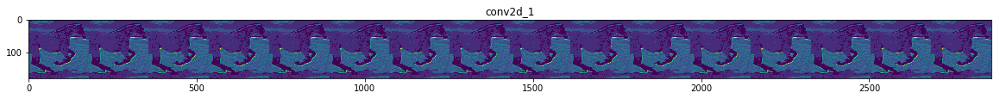

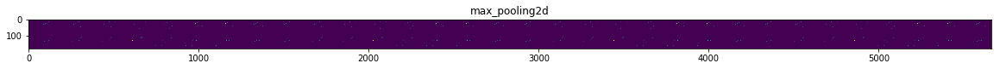

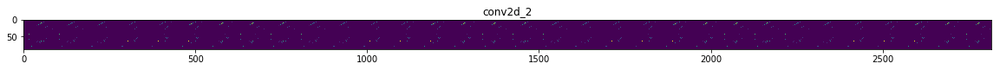

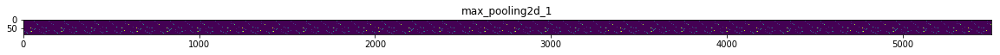

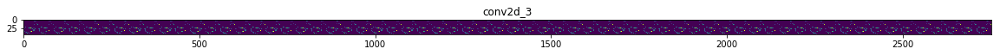

...

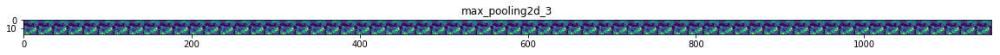

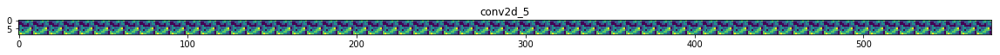

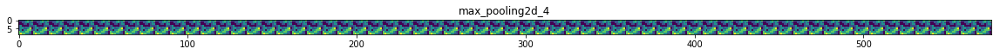

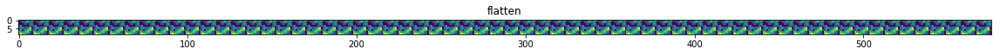

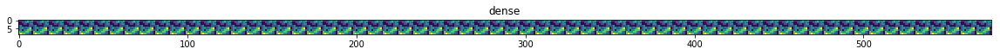

In [0]:
#Visualising intermediate representations

import numpy as np
import random
from tensorflow.keras.preprocessing.image import img_to_array,load_img

#lets define a new model that will take an image as an input and generate intermediate representations for all layers of the previous model

successive_outputs = [layer.output for layer in model.layers[1:]]
visualisation_model = tf.keras.models.Model(inputs = model.input, outputs = successive_outputs)

horse_img_files = [os.path.join(train_horse_dir,f) for f in train_horse_names]
human_img_files = [os.path.join(train_human_dir,f) for f in train_human_names]


img_path = random.choice(horse_img_files + human_img_files)
img = load_img(img_path,target_size=(360,360))
x=img_to_array(img)
x = x.reshape((1,)+x.shape)

x /=255

#run through all feature maps and get the intermediate representation of the image
successive_feature_maps = visualisation_model.predict(x)

#get the layer names ,to have them as part of our plot
layer_names = [layer.name for layer in model.layers]

#now display part of our representation

for layer_name,feature_map in zip(layer_names,successive_feature_maps):
  if len(feature_map.shape) == 4:
    n_features = feature_map.shape[-1] #no of features in feature map
    size = feature_map.shape[1]
    display_grid = np.zeros([size,size*n_features])
    for i in range(n_features):
      x = feature_map[0,:,:,1]
      x-=x.mean()
      x/=x.std()
      x*-64
      x+=128
      x = np.clip(x,0,255).astype('uint8')
      #tile each filter in to a big horizontal grid
      display_grid[:,i*size:(i+1)*size]=x
      
   #Display the grid
  scale = 20./n_features
  plt.figure(figsize=(scale*n_features , scale))
  plt.title(layer_name)
  plt.grid(False)
  plt.imshow(display_grid,aspect='auto',cmap='viridis')
      


<Figure size 432x288 with 0 Axes>

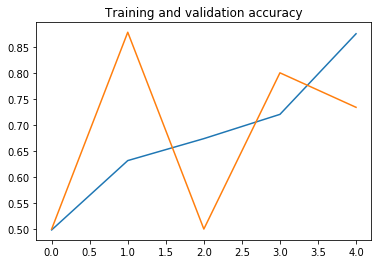

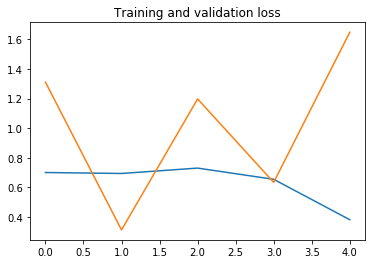

<Figure size 432x288 with 0 Axes>

In [9]:
#plotting the learning history of this model and loss

#get the training acc and validation acc for each epoch
acc = history.history['acc']
val_acc = history.history['val_acc']

#get the results of training data as a list
loss = history.history['loss']
val_loss = history.history['val_loss']

#get the length of trainign
epochs = range(len(acc))

#plot the training and validation acc per epoch
plt.plot(epochs,acc)
plt.plot(epochs,val_acc)
plt.title("Training and validation accuracy")
plt.figure()

#plot the loss per epoch
plt.plot(epochs,loss)
plt.plot(epochs,val_loss)
plt.title("Training and validation loss")
plt.figure()
